### Syllabus 

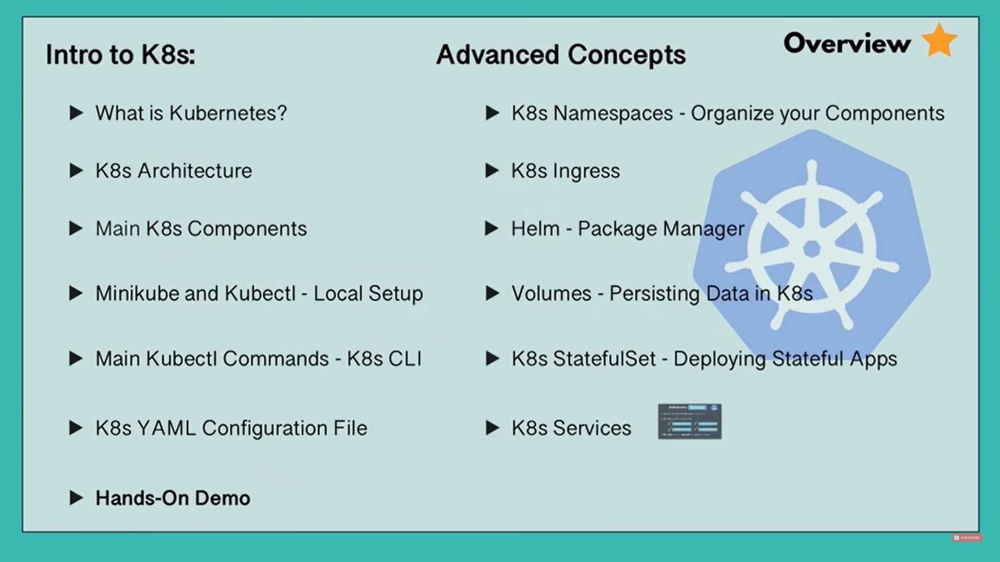

### What is kubernetes

- Open source container orchestration tool
- Manage containerized applications in different deployment env
- High Availability or no downtime 
- Scalability or High Performance
- Disaster recovery - backup and restore

### Components of Kubernetes

- Node : Simple Server (Physical or virtual machine)
- POD : 
    - Smallest unit of K8 . POD creates running env or layer on top of the container.
    - Usually there is only one application per pod 
    - Each POD have its own IP address 
    - Whenever any POS is crashed . New POD is created and new IP Address is assigned to it .
    - So everytime POD is crashed . New POD is created and new IP Address is assigned . Then we will have to change this IP  address multiple times. So Service and Ingress is used over here
    
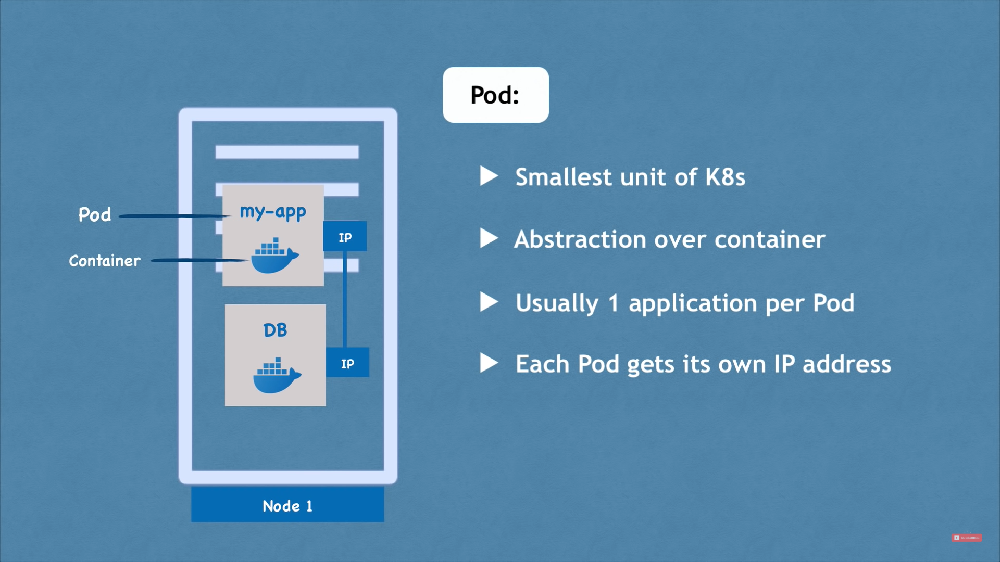

#### Services

- Permanent IP address is assigned to each POD with the help of Service
- Life cycle of POD and Service is not linked. So even if POD Dies . IP address will be there.

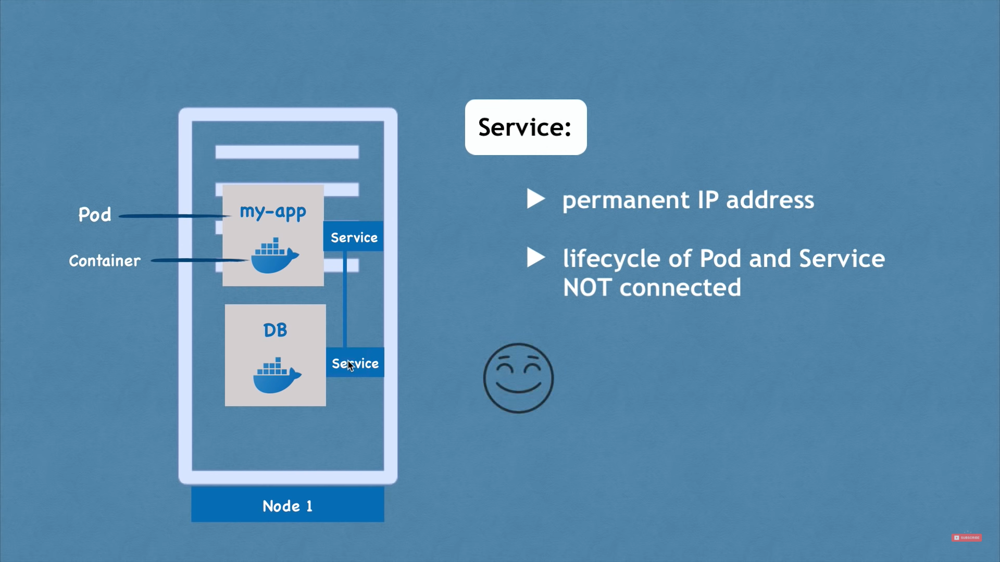

There are 2 types of services 
- Public Services (App link)
- Internal Service (We cannot expose DB)

#### Ingress

- URL of External services can be http://124.87.34.1:8080 (This type of link is not recommended .
- So instead of Service . Request first go to Ingress . Which then do the forwarding to Service

Example - https://my-app.com

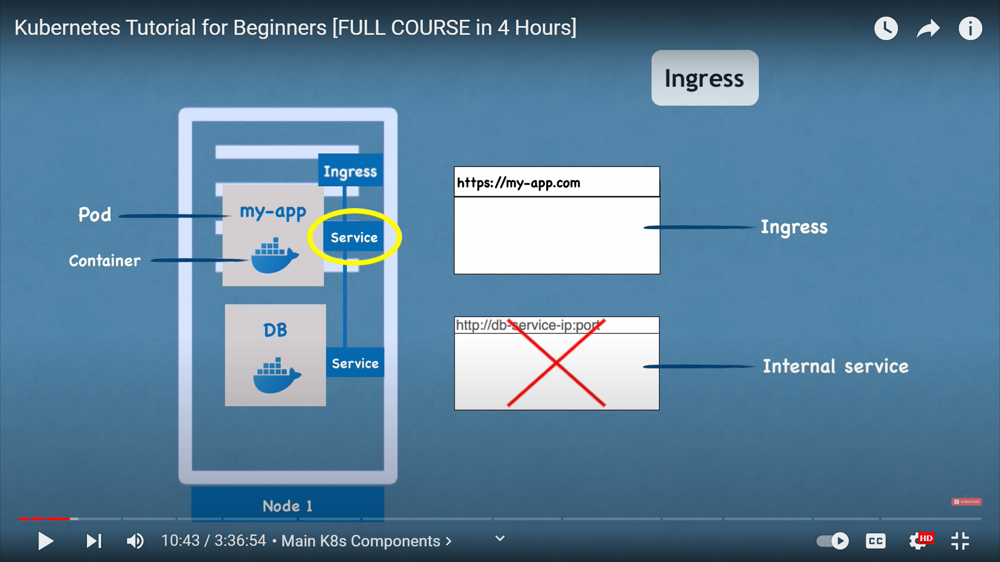

### ConfigMap and Secret

- PODS communicate each other with service .
- Assume DB Service has a database endpoint "mongo-db-service" . And our app wants to connect to this service .
- Database endpoint is usually done inside the application. If endpoint name is changed to "mongo-db". We will have to adjust in application and again we will have to build the application . Which is a very length process

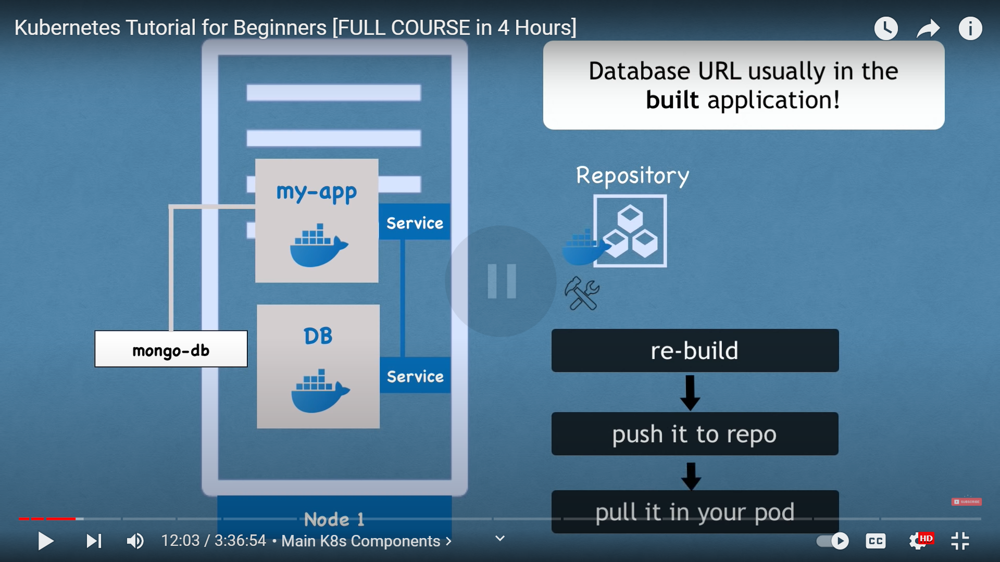

#### CONFIG MAP 

So instead of doing above things we can use CONFIG MAP which will have external configuration of application . We can add all URL and other details of services in config map 

NOTE : 

We will have to connect it to POD 

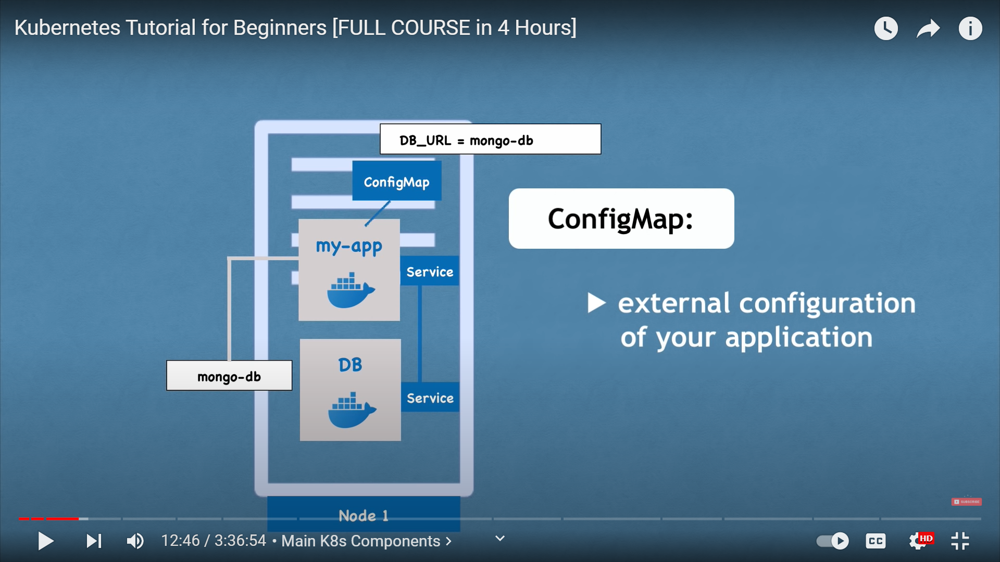

#### SECRET 

- We can use SECRET to store confidential information 
- It is used to store secret data in base64 encoded 

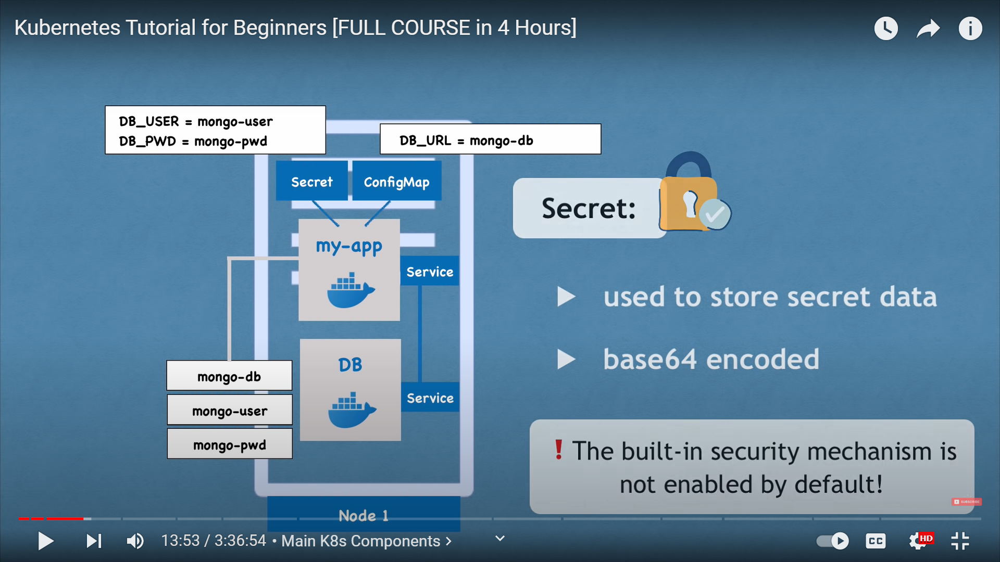

#### Volumes

- If POD gets restarted . Data is lost. 
- It is similar to volumes of Docker

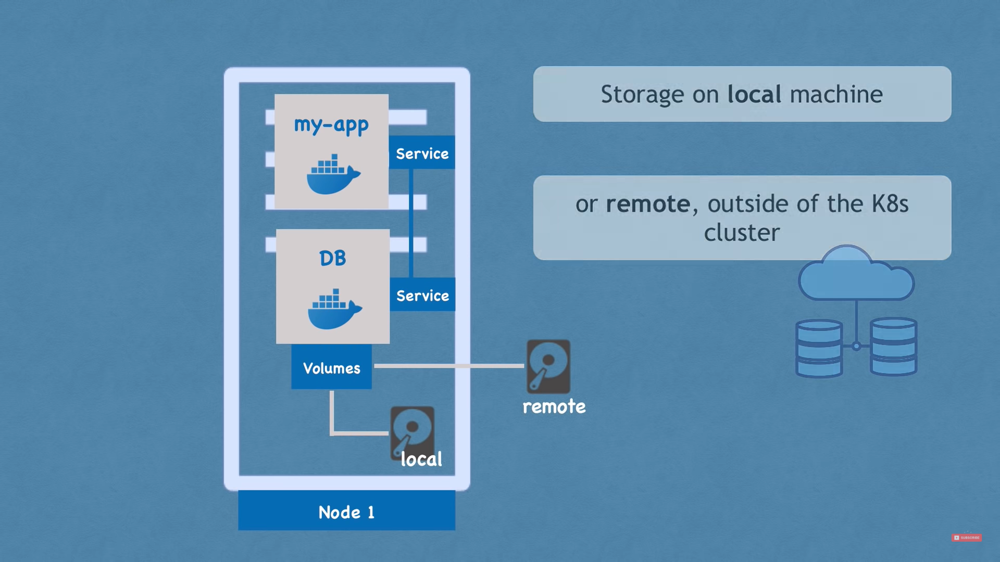

#### Deployment and Stateful Set

- What if the Application POD Dies .
- So instead of relying on One Application POD or One Database POD . We will replicate everything in multiple Servers or Nodes 
- This Replica Node will also be connected to the SERVICE 
- Here Service will act as Load balancer as well.

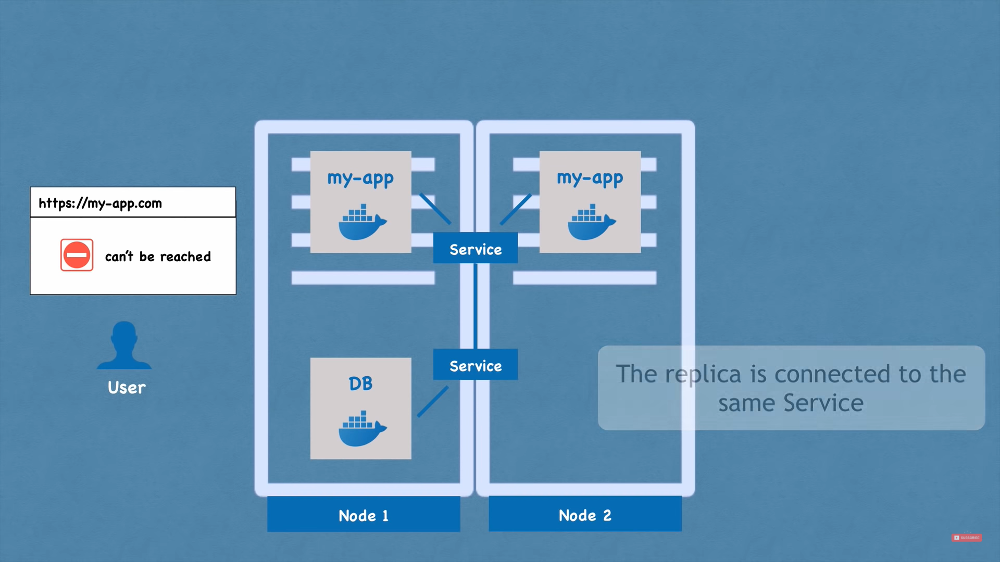

#### DEPLOYMENT 

- For creating 2nd POD . We will not create everything from scratch and create 2nd POD . We will define BLUEPRINTS for PODS. We will specify How many REPLICAS we need in DEPLOYMENT

- POD is on top of Docker Container 

- Deployment is on top of POD

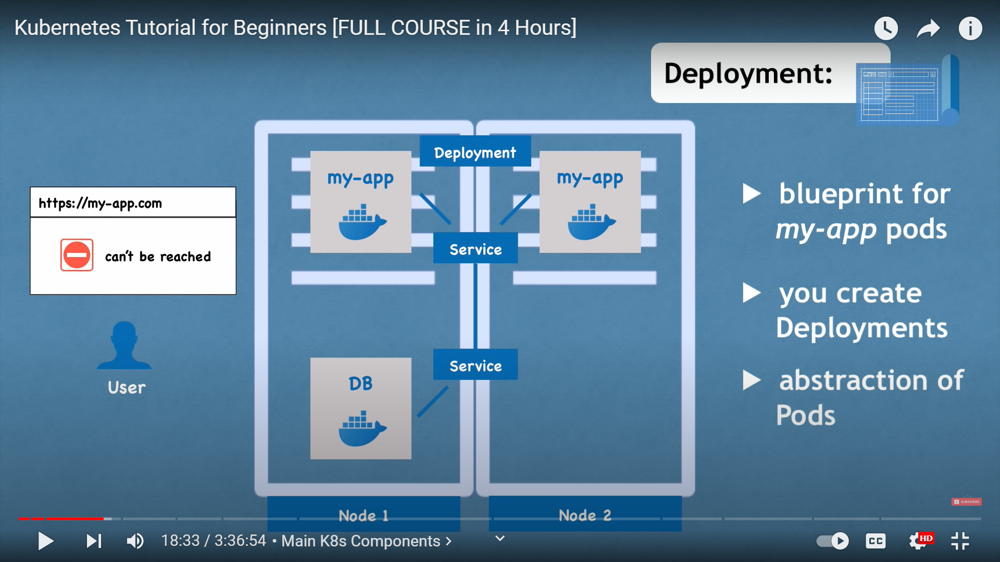

So if one of application pod will die . Then deployment will forwards the request to replica pod

##### Deployment - DB Service - Can be done via STATEFUL SET

We cannot replicate DB Service in Deployment . Because Database has state . Meaning all replicas and master service should use same shared Datastorage or Database . So here we will need mechanism which will tell us which PODS are reading from the database and which PODS are writing to the database 

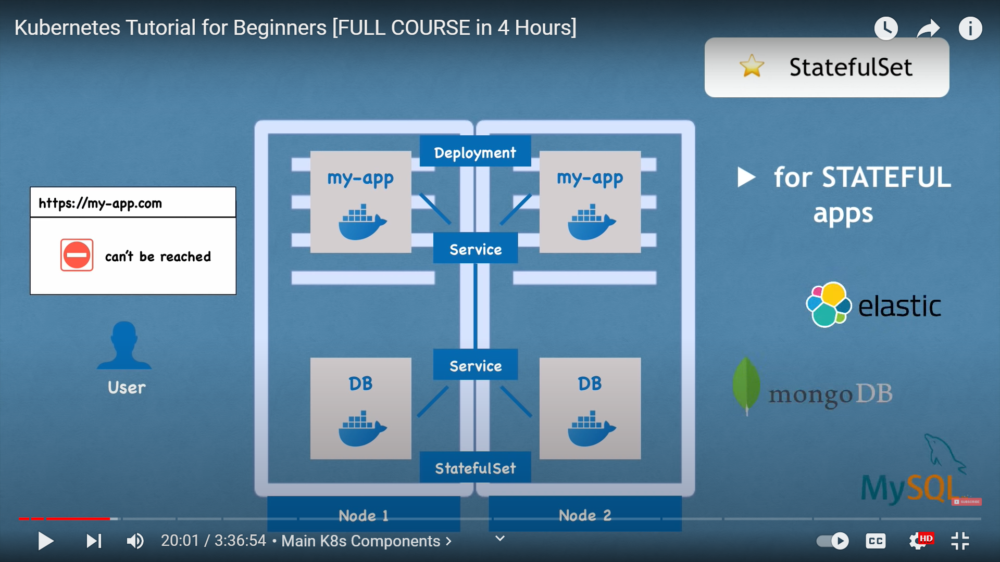

#### Kubernetes Architecture

- There are two types of nodes (Master and Slave Node)

#### Node Processes 

**One Node - 1 Application POD and 1 DB POD Setup**

- Each node has multiple POD on it
- 3 processes should be installed on every node
    - Container Runtime (Docker)
    - Kubelet : Interacts with both - Container and node i-e Kubelets starts the POD with a container inside
    - Kubeproxy : It forwards the request optimally . i-e If App POD wants DB access through DB Service . Kubeproxy will forwards the request to same DB POD of same cluster
- Worked Node do the actual work.

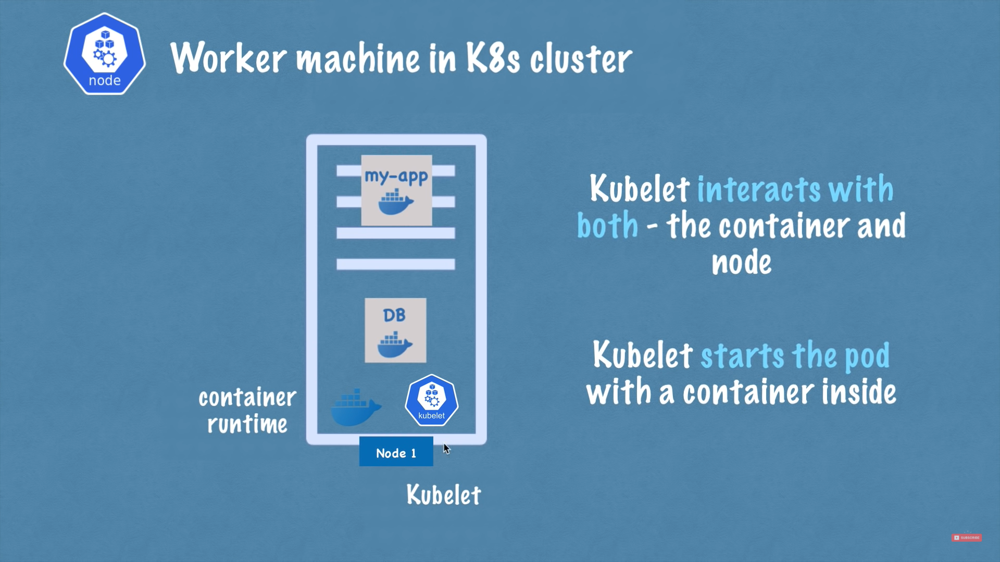

Usually kubernetes cluster is made up of multiple nodes . Communication between this nodes is done via Services 

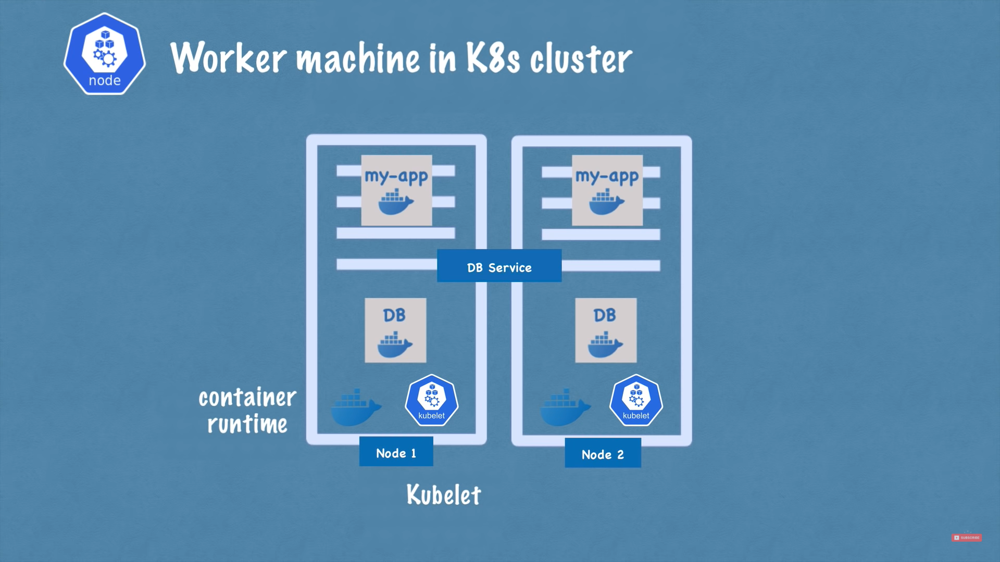

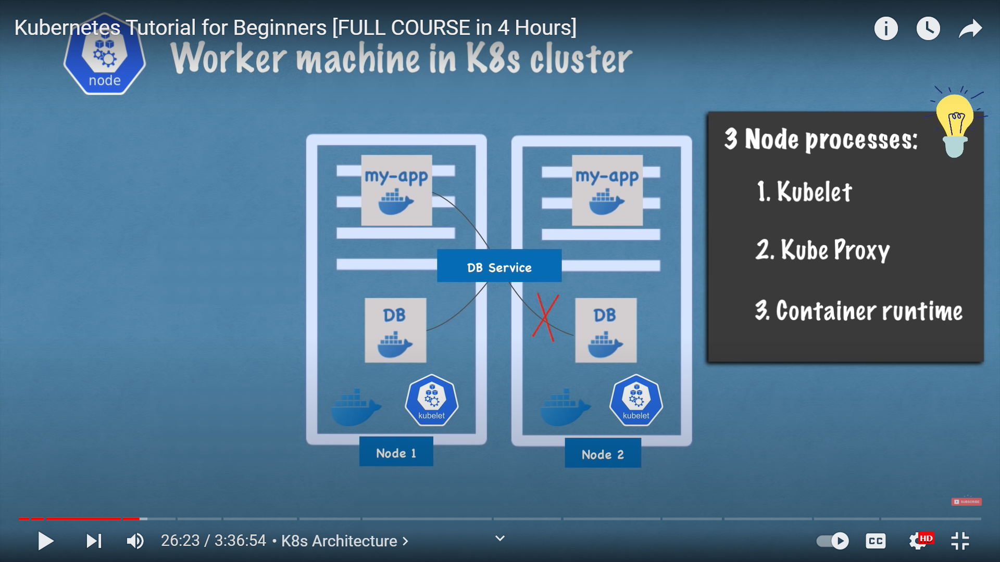

#### MASTER Node

- How to interact with Cluster (On Which Node - Application Node or Database node is need to be scheduled or run), How to schedule POD , Monitor , Reschedule / Restart POD ,JOIN New node (All this is done via Master Node)

There are 4 processes which runs on Master Node 
##### 1. API Server

If you want to deploy new application in kubernetes cluster . You will use Client (Kubernetes Dashboard,Command line tool like kubelet, Kubernetes API) to connect to API Server - Cluster Gateway (All requests are passed through API Server . All initial requests of any updates or queries of cluster goes thorough API Server). It also acts as a Gate keeper for authentication . Then only request is passed to other processes

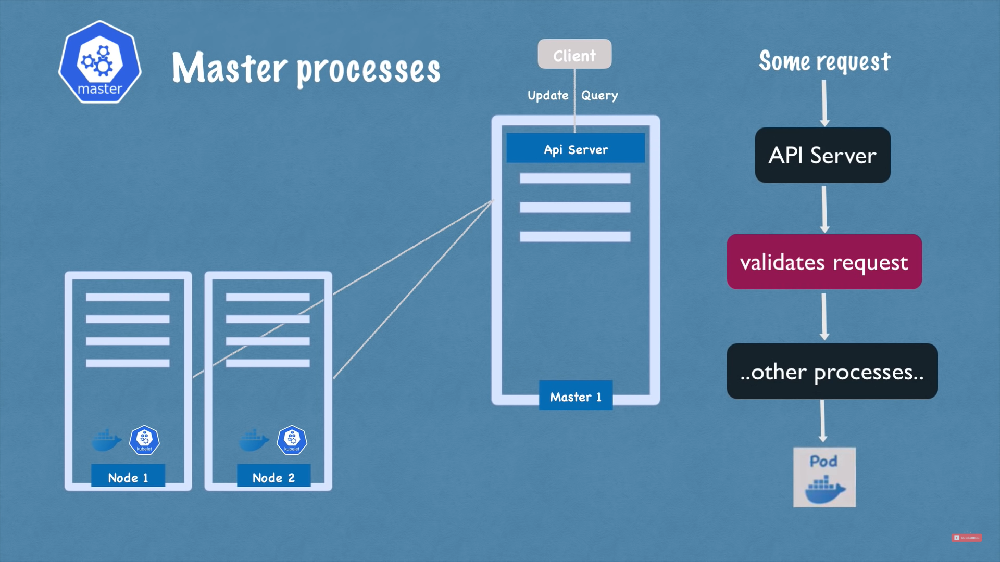

##### 2. Scheduler 

After validating the request(Schedule POD) by API Server . It is handed over to scheduler in order to start the application POD in one of worker node . It places the POD/Component optimally 

Scheduler will check - How many resources/cpu/memory POD needs and then it will look through all the worker nodes . If any of the worker node is least busy . POD will be assigned to that node .

- Scheduler will only decide on which Node POD will be scheduled. Actually Kubelet will be the one which will execute the request 

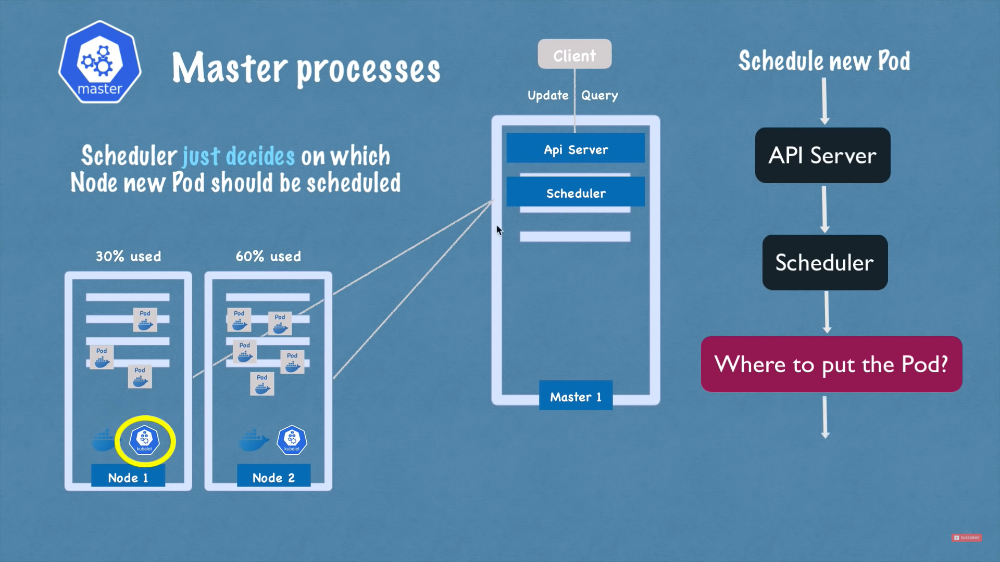

#### 3. Controller Manager 

- If POD Dies in any of the node . Controller manager will detect the cluster state changes (Crashing of POD) . Then it will retry to reschedule that POD and maintain Cluster State 

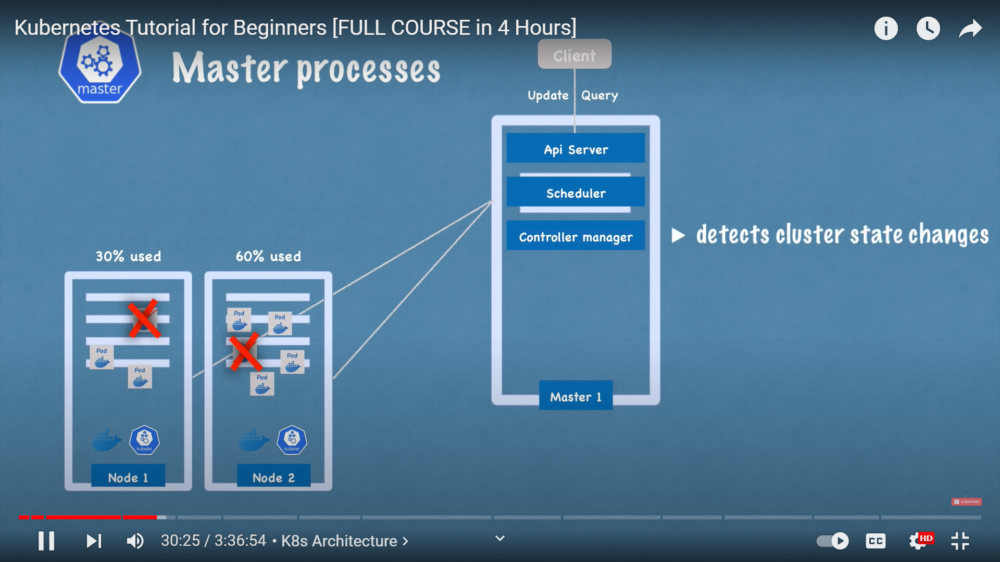

Controller Manager will tell to Scheduler . Scheduler will then decide on which worker node . POD can be created . Kubelet will then start the POD 

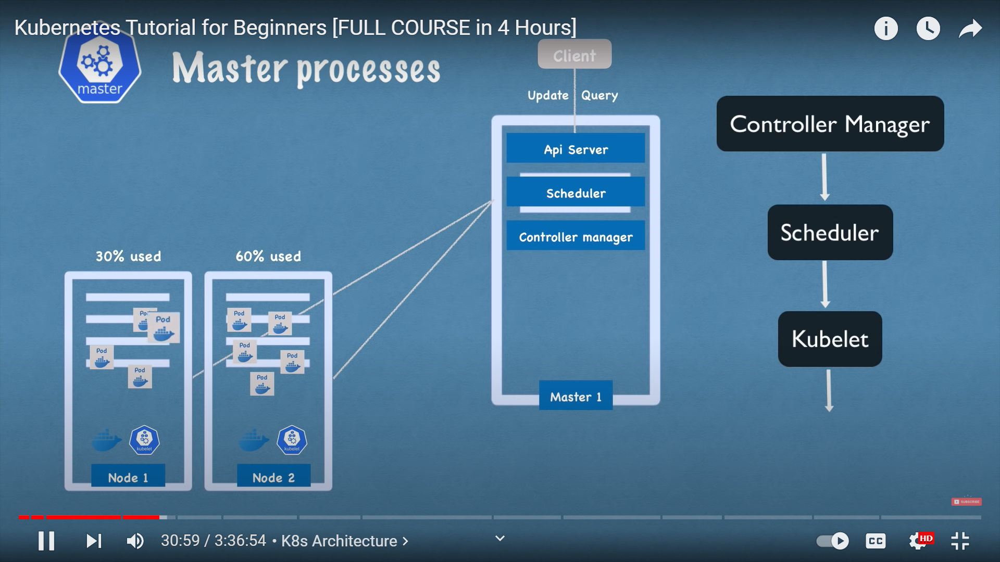

#### 4. ETCD (Cluster Manager)

Every change in cluster gets stored in key value form in etcd

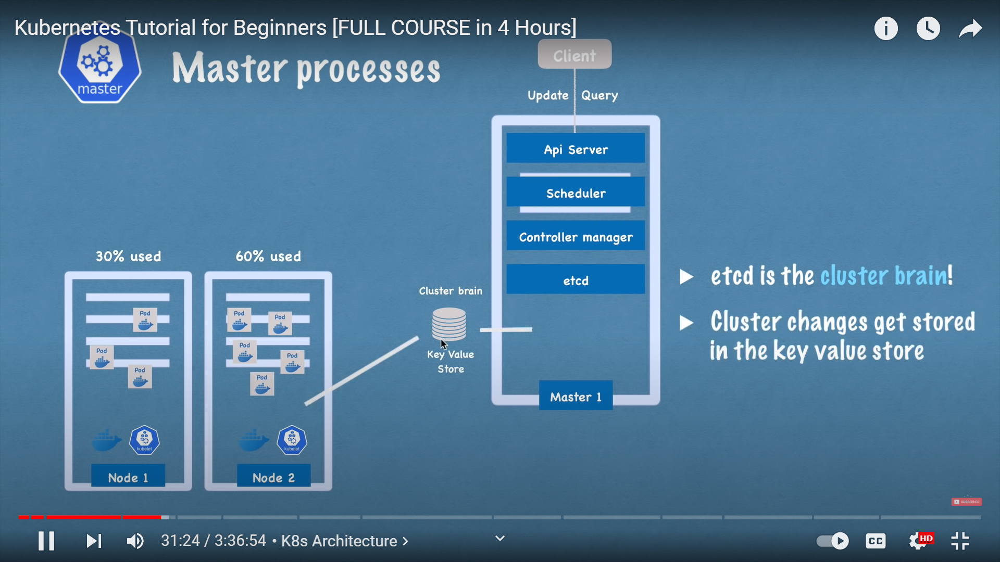

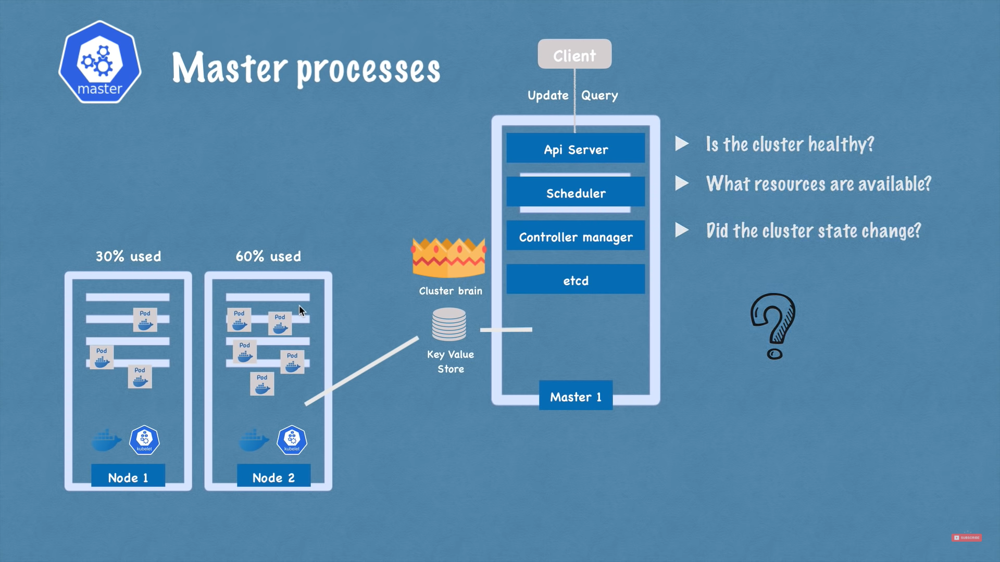

Application Data is not stored in ETCD

MASTER Node also has its replica 

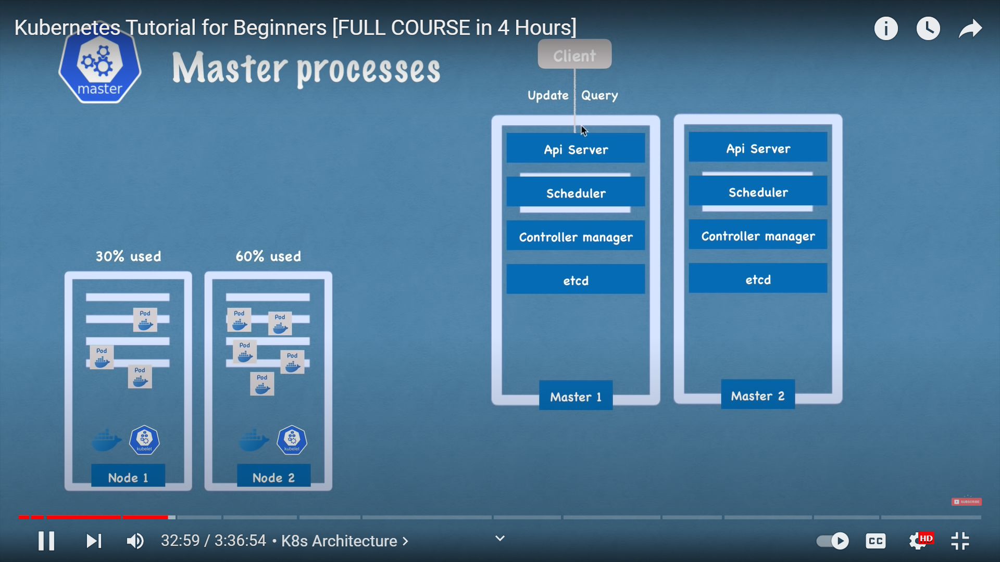

#### Example of Cluster Setup 

One Cluster :
- 3 Master Nodes
- 5 Worker Nodes 

MASTER NODES :
- Have less work load 
- They require less resources (CPU/RAM/Memory)

WORKER NODES :
- Have more work load 
- They require more resources (CPU/RAM/Memory)

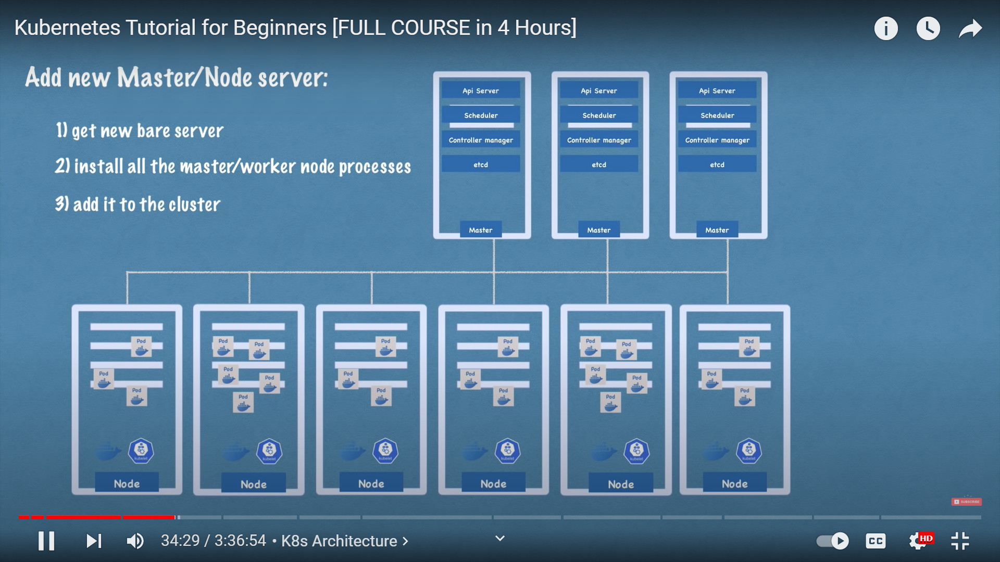

### Minikube and Kubectl

What is Minikube

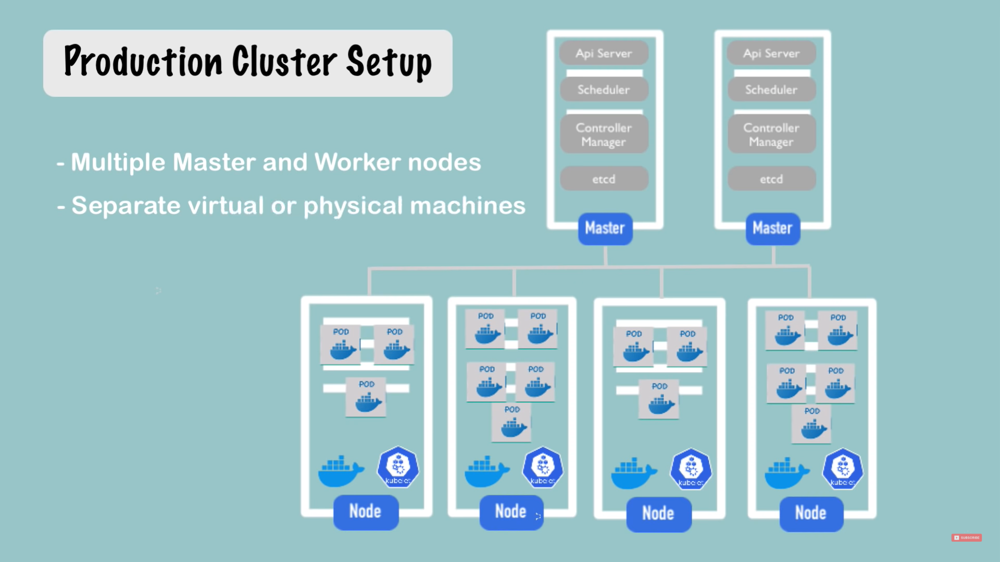

We can't get multiple servers in Local setup . We can use Open source Tool - Minikube 

#### Minikube 

- It is a One Node Cluster 
- Master and Worker Processes . Both run on One Node 
- It has docker pre installed 

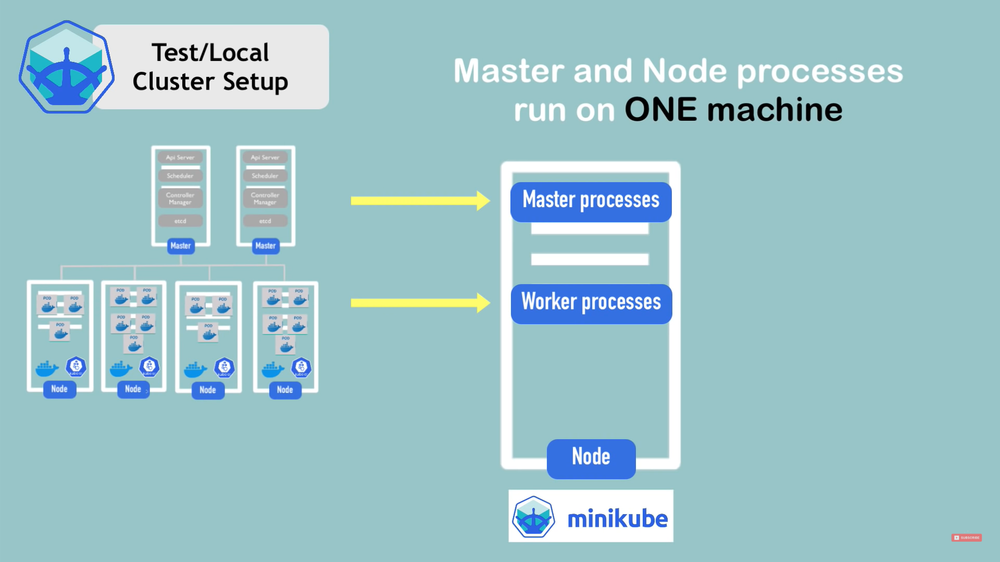

It runs on your laptop - Virtual Box 

#### Test/Local Cluster Setup 

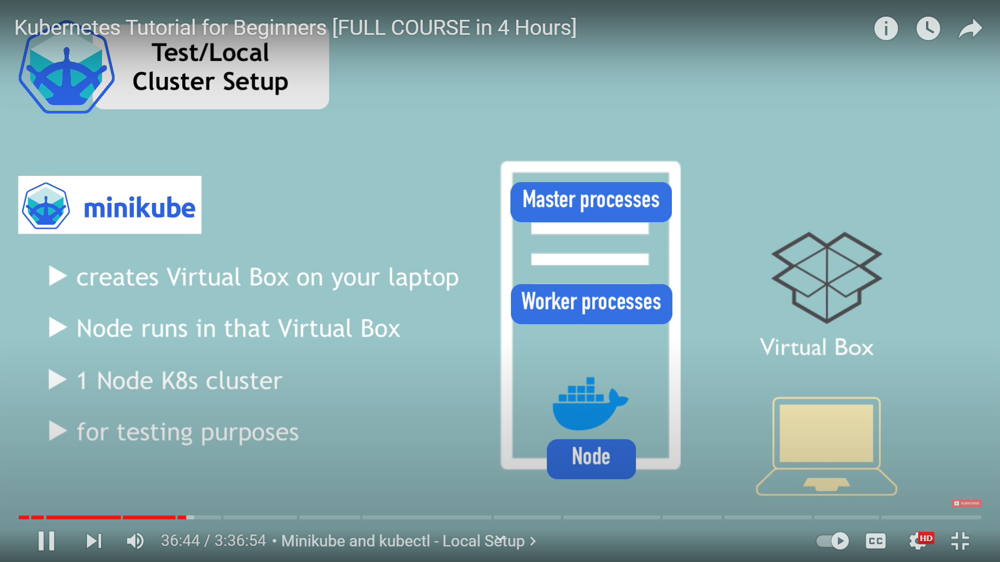

#### Kubectl 

- To interact with cluster which is setup on Minikube . Kubectl is used 
- Create PODS,And settip up services,inrgess,config map,secrets. Kubectl is used 
- It is command line tool for kubernetes cluster 

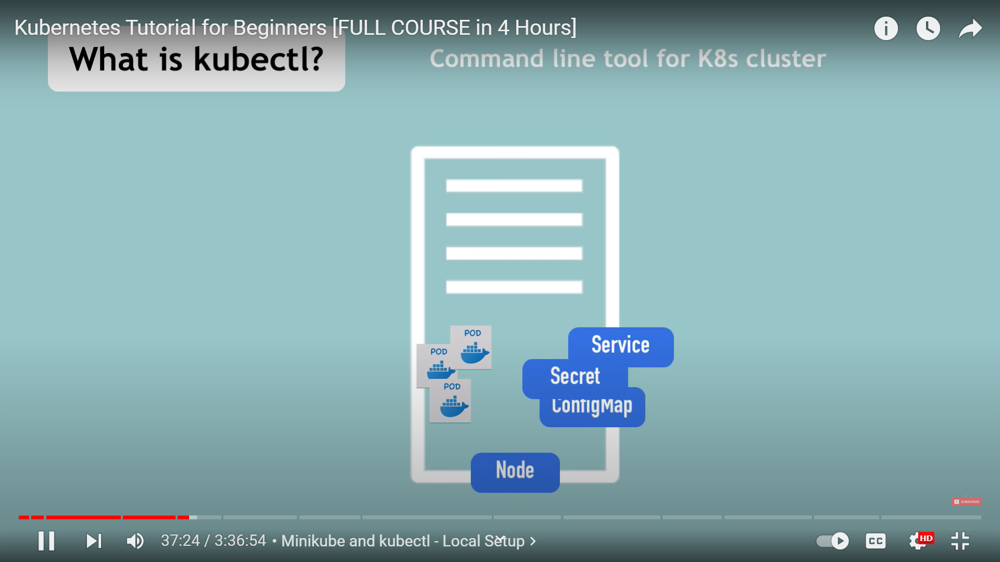

Now lets assume .You have setup a Master Process in Node . Master process has API Server which is entry point of the Master Process. Now you know that to interact with API Server . Client is used. One of the client is KUBECTL

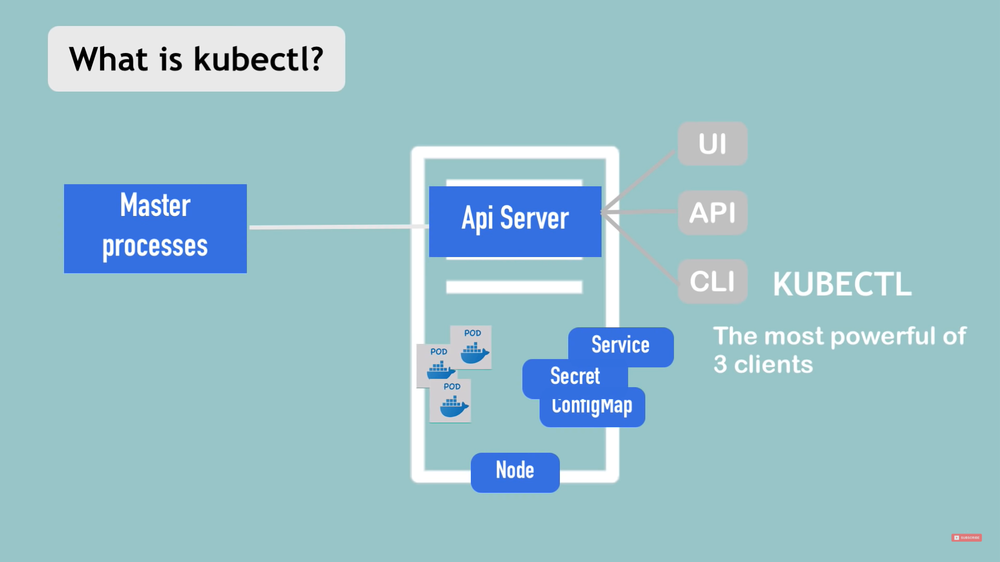

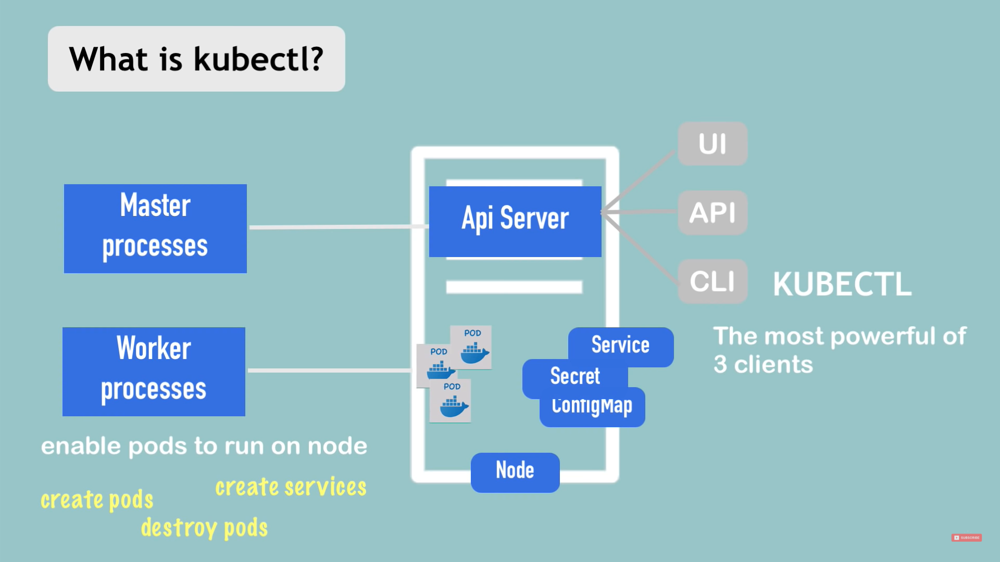

KUBECTL can be used for Minikube CLuster or CLoud cluster 

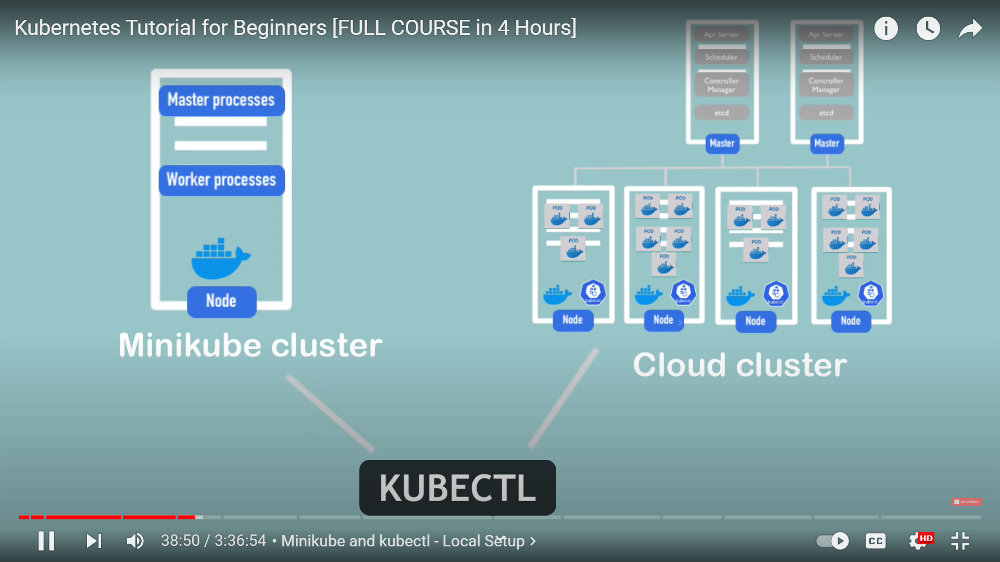

#### Minikube and Kubectl 

Check Important Commands Notes 

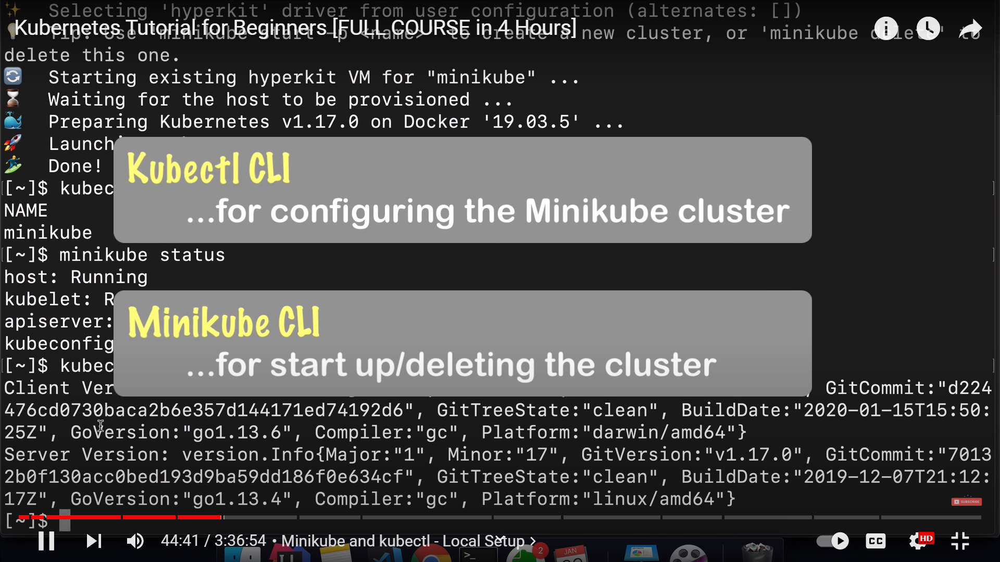